### Libs

In [2]:
from torchvision.datasets import CelebA
import os
import torch.nn as nn
import glob
import os
import torch
from torch.utils.data import Dataset
import numpy as np
import pandas as pd
from PIL import Image
import matplotlib.pyplot as plt
import os
import torch
import math
# main libraries
import os
import numpy as np
import matplotlib.pyplot as plt
import torch
from torch.utils.data import DataLoader
from torch.utils.data import SubsetRandomSampler
from torch.nn import functional as F
from torch import nn
from torch import optim
import torchvision
from torchvision import transforms, datasets
from torch.utils.data import Dataset
import math
import torchvision.transforms.functional as TF
import cv2
from keras.utils import image_dataset_from_directory
from torchvision import datasets, transforms
from torch.utils.data import random_split
from torch.nn.parameter import Parameter

from torch.nn import init
from torchvision.utils import make_grid
from collections import OrderedDict

import torch
from torch.utils.data import Dataset

from skimage import transform
import skimage.io as io
import numpy as np
from torchvision.utils import save_image

### Helper Functions

In [3]:
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

In [4]:
def ploter(image, image_hat):
    """
    (H, W)
    """
    plt.figure()
    plt.subplot(1,2,1)
    #plt.imshow(image_hat, cmap='gray', vmin=-1, vmax=1)
    plt.imshow(image_hat)
    plt.tight_layout()
    plt.title("Reconstruct")

    plt.subplot(1,2,2)
    #plt.imshow(image, cmap='gray', vmin=-1, vmax=1)
    plt.imshow(image)
    plt.tight_layout()
    plt.title("Original")

    plt.show()

### Dataloader

In [5]:
class Anomaly_Dataset(Dataset):
    def __init__(self,
                 root
                 ):
        super(Anomaly_Dataset, self).__init__()

        self.data = Anomaly_Dataset.load_dataset(root)
        self.image, self.label = Anomaly_Dataset.get_numpy(self.data)

    def __getitem__(self, item):
        x, y =  self.image[item], self.label[item]

        # RGB -> GRAY : (H, W)
        x = x[:,:,0]

        # (1, H, W)
        x = Anomaly_Dataset.normalization(x)
        #x = np.expand_dims(x, axis=0)

        return x, y


    def __len__(self):
        return len(self.data)


    @staticmethod
    def load_dataset(path):
        img_rows = 96
        img_cols = 96
        return image_dataset_from_directory(directory = path,
                                               label_mode = 'int',
                                               color_mode = 'rgb',
                                               shuffle = False,
                                               batch_size = None,
                                               image_size = (img_rows, img_cols),
                                               crop_to_aspect_ratio = True)

    @staticmethod
    def get_numpy(PrefetchDataset):
        """
        return:
            (N, H, W, C) , (N,)
        """
        images = []
        labels = []
        for (image, label) in PrefetchDataset:
            images.append(image)
            labels.append(label)
        return np.array(images), np.array(labels)

    @staticmethod
    def rgb_2_gray(x):
        """
        (H, W, C) --> (H, W)
        """
        return cv2.cvtColor(x, cv2.COLOR_BGR2GRAY)

    @staticmethod
    def normalization(x):
        """
        Args:
            x : np.array : (H, W)

        Return:
            np.array : (H, W)
        """
        x = x - x.min(keepdims=True)
        x = x / x.max(keepdims=True)
        x = x - 0.5
        return  x / 0.5

### Nets

In [6]:
class Generator(nn.Module):
    def __init__(self, img_size, latent_dim, channels):
        super(Generator, self).__init__()

        self.init_size = img_size // 4
        self.linear_layer = nn.Sequential(nn.Linear(latent_dim, 128 * self.init_size ** 2))

        self.conv_layers = nn.Sequential(
            nn.BatchNorm2d(128),
            nn.Upsample(scale_factor=2),
            nn.Conv2d(128, 128, 3, stride=1, padding=1),
            nn.BatchNorm2d(128, 0.8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Upsample(scale_factor=2),
            nn.Conv2d(128, 64, 3, stride=1, padding=1),
            nn.BatchNorm2d(64, 0.8),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(64, channels, 3, stride=1, padding=1),
            nn.Tanh(),
        )

    def forward(self, z):
        out = self.linear_layer(z)
        out = out.view(out.shape[0], 128, self.init_size, self.init_size)
        image = self.conv_layers(out)
        return image


class Discriminator(nn.Module):
    def __init__(self, channels, img_size):
        super(Discriminator, self).__init__()

        def discriminator_block(in_filters, out_filters, bn=True):
            block = [nn.Conv2d(in_filters, out_filters, 3, 2, 1), nn.LeakyReLU(0.2, inplace=True), nn.Dropout2d(0.25)]
            if bn:
                block.append(nn.BatchNorm2d(out_filters, 0.8))
            return block

        self.conv_layers = nn.Sequential(
            *discriminator_block(channels, 16, bn=False),
            *discriminator_block(16, 32),
            *discriminator_block(32, 64),
            *discriminator_block(64, 128),
        )

        self.ds_size = img_size // 2 ** 4
        self.adverse_layer = nn.Sequential(nn.Linear(128 * self.ds_size ** 2, 1), nn.Sigmoid())

    def forward(self, image):
        out = self.conv_layers(image)
        out = out.view(out.shape[0], -1)
        validity = self.adverse_layer(out)
        return validity

In [7]:
generator = Generator(img_size=96, latent_dim=100, channels=3).cuda()
count_parameters(generator)

7670275

In [8]:
discriminator = Discriminator(3, 96)
count_parameters(discriminator)

102497

### Hyperparameters

In [29]:
#root_save = "./best_models"
#root_ds = "./../../dataset/kaggle1/no"

root_save = "/content/drive/MyDrive/MRI Arman/best_models"
root_ds = "/content/drive/MyDrive/MRI Arman/dataset/kaggle1/no"

batch_size = 10
img_size = 96
latent_dim = 100
channels = 1
num_epochs = 5000
sample_interval = 20

### Dataset

In [16]:
dataset = Anomaly_Dataset(root_ds)
dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

Found 91 files belonging to 1 classes.


### Loss

In [23]:
generator = Generator(img_size=img_size, latent_dim=latent_dim, channels=channels).cuda()
discriminator = Discriminator(channels=channels, img_size=img_size).cuda()

In [24]:
adversarial_loss = nn.BCELoss()
optimizer_G = optim.Adam(generator.parameters())
optimizer_D = optim.Adam(discriminator.parameters())

In [25]:
def weights_init_normal(m):
    classname = m.__class__.__name__
    if classname.find("Conv") != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find("BatchNorm2d") != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0.0)

In [26]:
generator = generator.apply(weights_init_normal)
discriminator = discriminator.apply(weights_init_normal)

### Train

<Figure size 432x288 with 0 Axes>

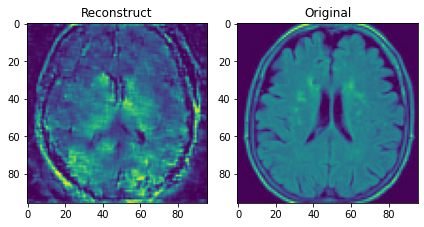

[Epoch 1000/5000] 	[D loss: 2.300] 	[G loss: 33.890]


<Figure size 432x288 with 0 Axes>

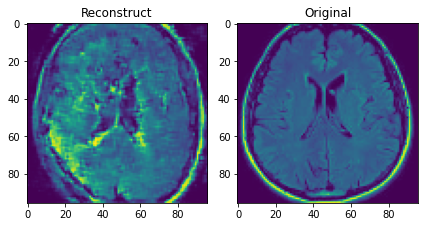

[Epoch 1020/5000] 	[D loss: 1.773] 	[G loss: 40.308]


<Figure size 432x288 with 0 Axes>

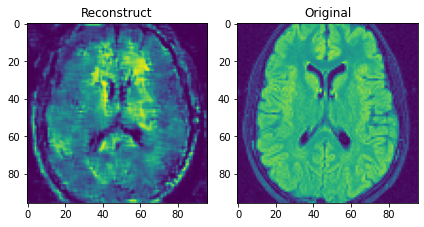

[Epoch 1040/5000] 	[D loss: 2.711] 	[G loss: 39.673]


<Figure size 432x288 with 0 Axes>

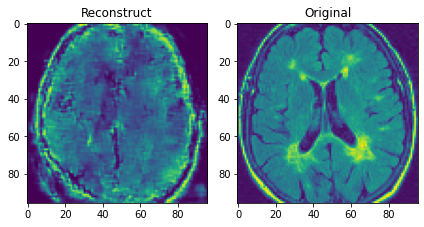

[Epoch 1060/5000] 	[D loss: 3.221] 	[G loss: 31.258]


<Figure size 432x288 with 0 Axes>

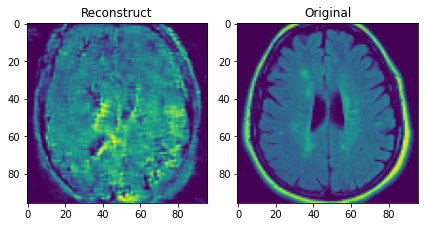

[Epoch 1080/5000] 	[D loss: 2.367] 	[G loss: 32.737]


<Figure size 432x288 with 0 Axes>

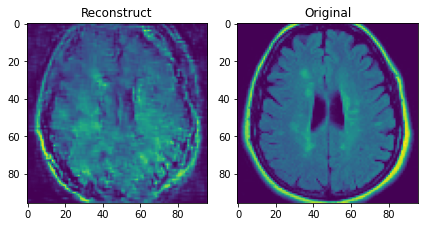

[Epoch 1100/5000] 	[D loss: 2.855] 	[G loss: 31.557]


<Figure size 432x288 with 0 Axes>

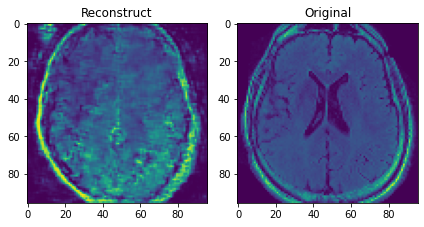

[Epoch 1120/5000] 	[D loss: 2.307] 	[G loss: 32.724]


<Figure size 432x288 with 0 Axes>

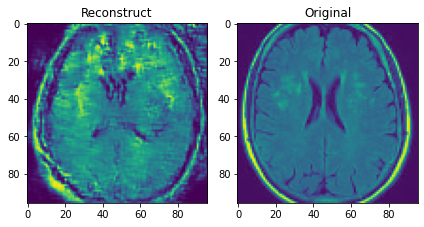

[Epoch 1140/5000] 	[D loss: 3.649] 	[G loss: 24.246]


<Figure size 432x288 with 0 Axes>

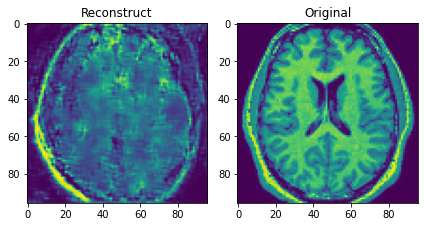

[Epoch 1160/5000] 	[D loss: 2.971] 	[G loss: 32.787]


<Figure size 432x288 with 0 Axes>

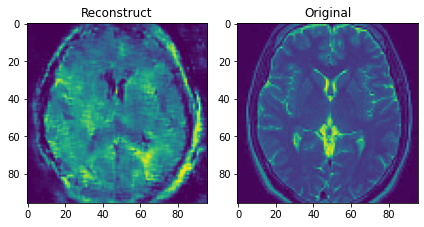

[Epoch 1180/5000] 	[D loss: 2.397] 	[G loss: 31.232]


<Figure size 432x288 with 0 Axes>

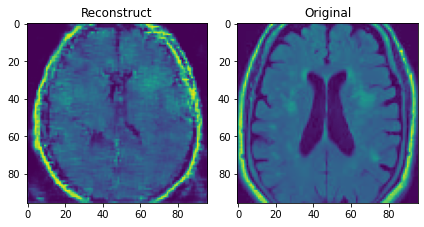

[Epoch 1200/5000] 	[D loss: 1.524] 	[G loss: 37.188]


<Figure size 432x288 with 0 Axes>

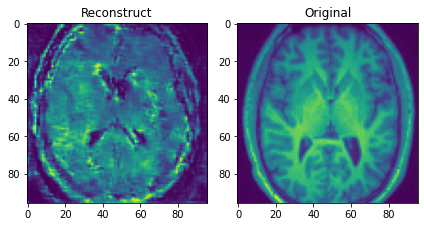

[Epoch 1220/5000] 	[D loss: 3.785] 	[G loss: 47.115]


<Figure size 432x288 with 0 Axes>

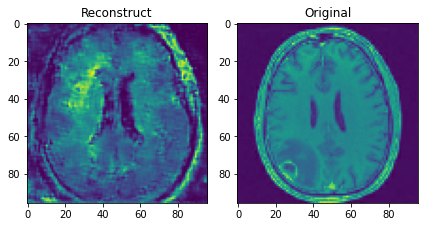

[Epoch 1240/5000] 	[D loss: 2.265] 	[G loss: 27.511]


<Figure size 432x288 with 0 Axes>

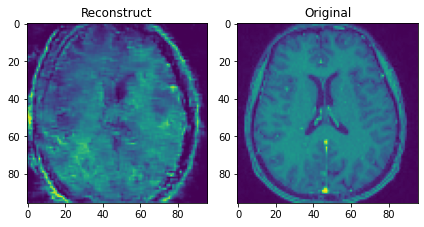

[Epoch 1260/5000] 	[D loss: 2.796] 	[G loss: 35.516]


<Figure size 432x288 with 0 Axes>

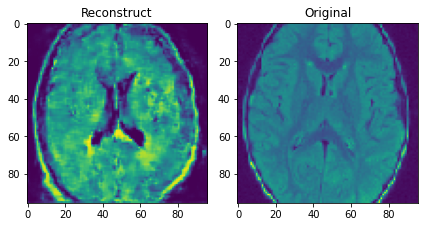

[Epoch 1280/5000] 	[D loss: 4.511] 	[G loss: 40.223]


<Figure size 432x288 with 0 Axes>

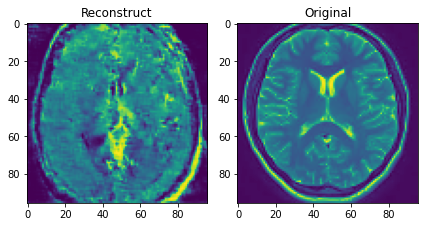

[Epoch 1300/5000] 	[D loss: 2.879] 	[G loss: 31.596]


<Figure size 432x288 with 0 Axes>

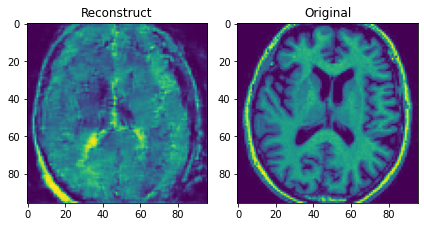

[Epoch 1320/5000] 	[D loss: 2.067] 	[G loss: 33.763]


<Figure size 432x288 with 0 Axes>

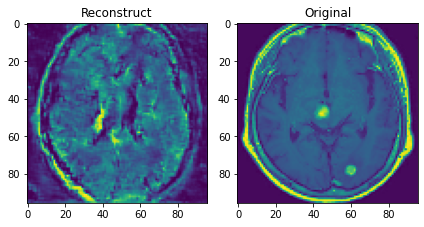

[Epoch 1340/5000] 	[D loss: 2.316] 	[G loss: 36.047]


<Figure size 432x288 with 0 Axes>

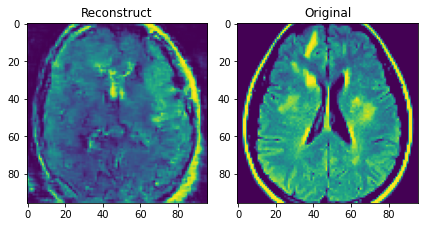

[Epoch 1360/5000] 	[D loss: 2.948] 	[G loss: 41.092]


<Figure size 432x288 with 0 Axes>

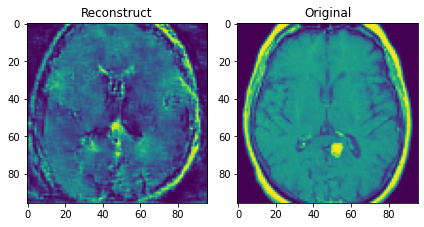

[Epoch 1380/5000] 	[D loss: 3.096] 	[G loss: 36.102]


<Figure size 432x288 with 0 Axes>

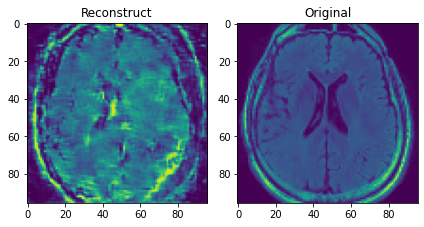

[Epoch 1400/5000] 	[D loss: 4.170] 	[G loss: 37.715]


<Figure size 432x288 with 0 Axes>

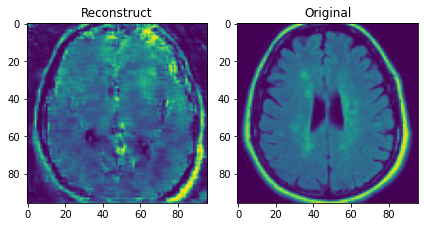

[Epoch 1420/5000] 	[D loss: 3.474] 	[G loss: 48.694]


<Figure size 432x288 with 0 Axes>

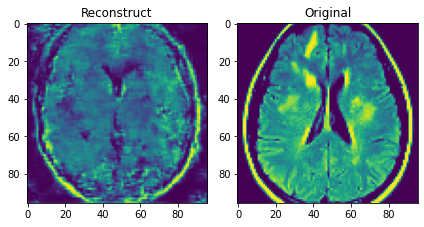

[Epoch 1440/5000] 	[D loss: 1.786] 	[G loss: 42.858]


<Figure size 432x288 with 0 Axes>

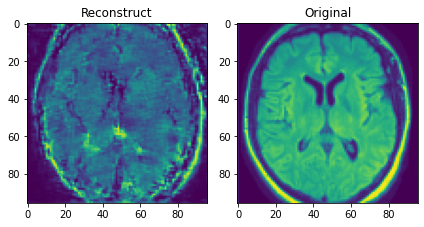

[Epoch 1460/5000] 	[D loss: 1.744] 	[G loss: 30.753]


<Figure size 432x288 with 0 Axes>

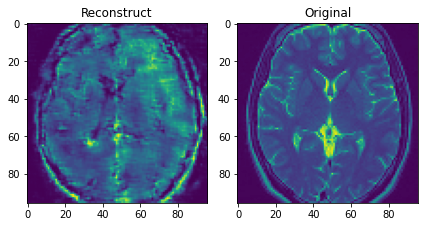

[Epoch 1480/5000] 	[D loss: 1.941] 	[G loss: 33.617]


<Figure size 432x288 with 0 Axes>

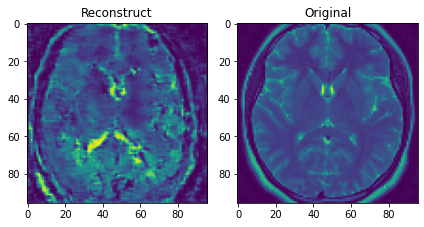

[Epoch 1500/5000] 	[D loss: 1.715] 	[G loss: 38.701]


<Figure size 432x288 with 0 Axes>

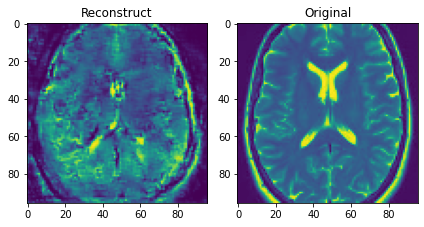

[Epoch 1520/5000] 	[D loss: 2.308] 	[G loss: 43.310]


<Figure size 432x288 with 0 Axes>

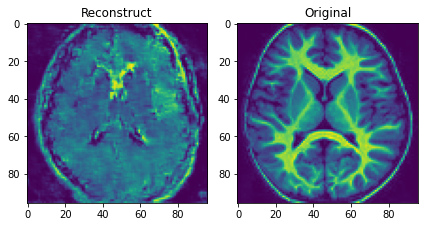

[Epoch 1540/5000] 	[D loss: 2.547] 	[G loss: 45.245]


<Figure size 432x288 with 0 Axes>

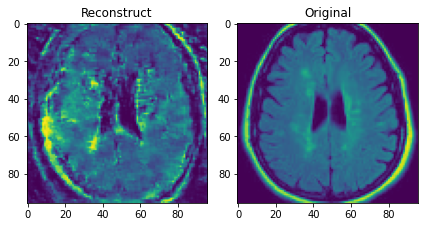

[Epoch 1560/5000] 	[D loss: 3.255] 	[G loss: 29.617]


<Figure size 432x288 with 0 Axes>

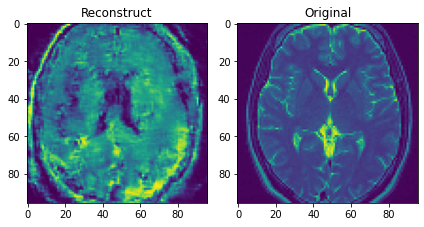

[Epoch 1580/5000] 	[D loss: 1.884] 	[G loss: 36.309]


<Figure size 432x288 with 0 Axes>

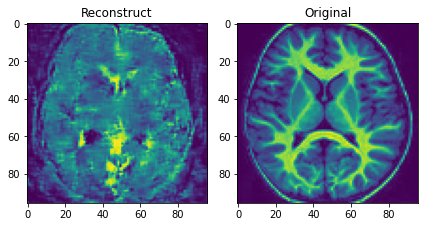

[Epoch 1600/5000] 	[D loss: 2.684] 	[G loss: 42.597]


<Figure size 432x288 with 0 Axes>

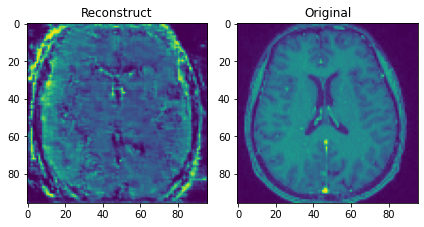

[Epoch 1620/5000] 	[D loss: 4.900] 	[G loss: 48.583]


<Figure size 432x288 with 0 Axes>

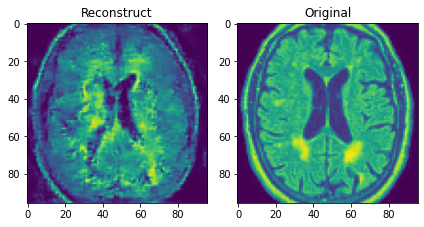

[Epoch 1640/5000] 	[D loss: 1.762] 	[G loss: 32.558]


<Figure size 432x288 with 0 Axes>

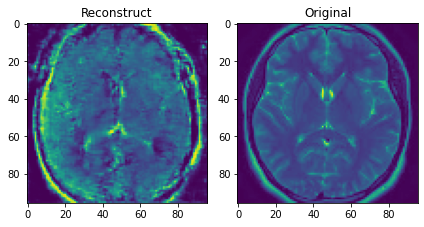

[Epoch 1660/5000] 	[D loss: 2.212] 	[G loss: 31.503]


<Figure size 432x288 with 0 Axes>

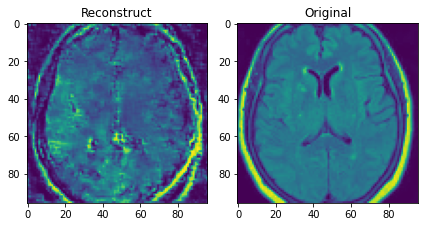

[Epoch 1680/5000] 	[D loss: 3.914] 	[G loss: 40.384]


<Figure size 432x288 with 0 Axes>

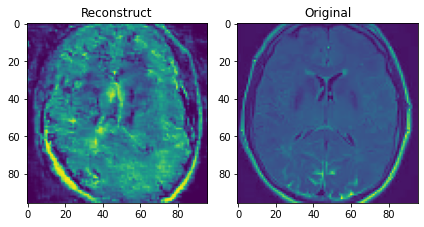

[Epoch 1700/5000] 	[D loss: 3.810] 	[G loss: 35.124]


<Figure size 432x288 with 0 Axes>

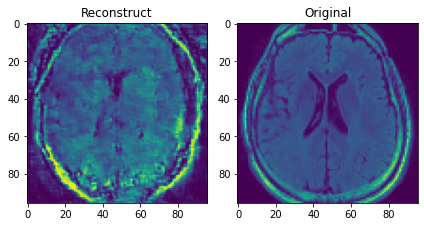

[Epoch 1720/5000] 	[D loss: 1.812] 	[G loss: 35.149]


<Figure size 432x288 with 0 Axes>

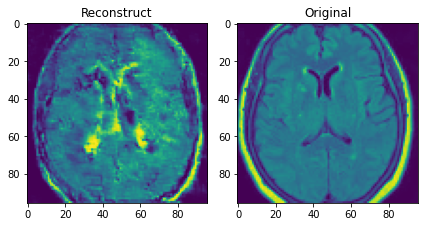

[Epoch 1740/5000] 	[D loss: 2.233] 	[G loss: 41.775]


<Figure size 432x288 with 0 Axes>

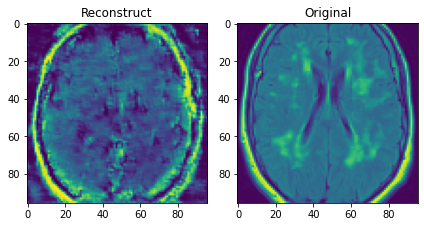

[Epoch 1760/5000] 	[D loss: 5.049] 	[G loss: 56.102]


<Figure size 432x288 with 0 Axes>

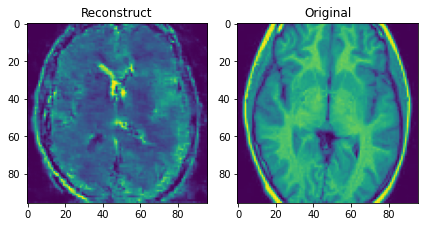

[Epoch 1780/5000] 	[D loss: 2.422] 	[G loss: 32.594]


<Figure size 432x288 with 0 Axes>

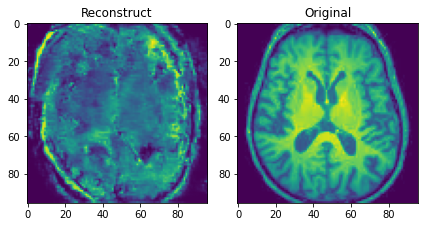

[Epoch 1800/5000] 	[D loss: 1.712] 	[G loss: 36.875]


<Figure size 432x288 with 0 Axes>

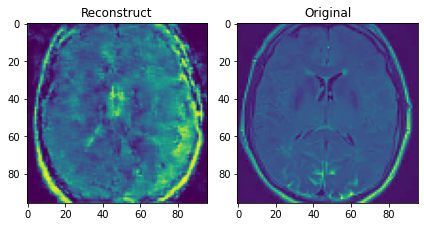

[Epoch 1820/5000] 	[D loss: 2.242] 	[G loss: 44.992]


<Figure size 432x288 with 0 Axes>

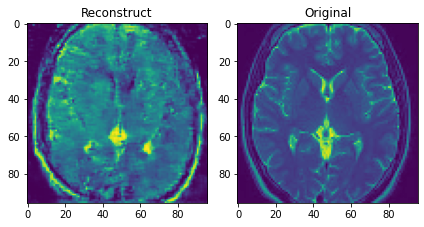

[Epoch 1840/5000] 	[D loss: 2.431] 	[G loss: 46.128]


<Figure size 432x288 with 0 Axes>

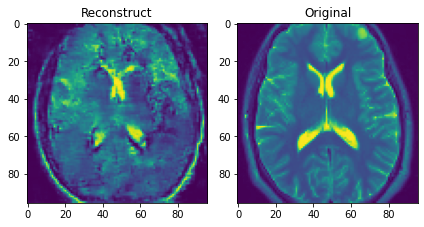

[Epoch 1860/5000] 	[D loss: 2.550] 	[G loss: 50.857]


<Figure size 432x288 with 0 Axes>

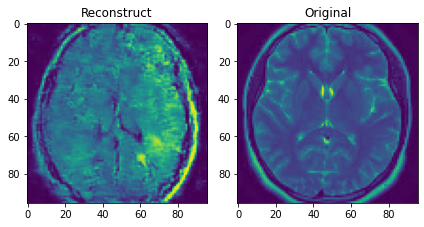

[Epoch 1880/5000] 	[D loss: 1.992] 	[G loss: 34.500]


<Figure size 432x288 with 0 Axes>

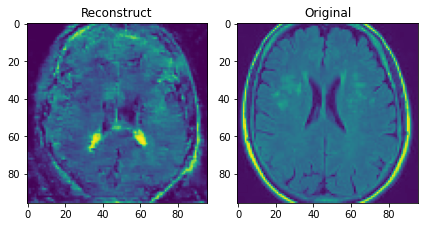

[Epoch 1900/5000] 	[D loss: 2.232] 	[G loss: 26.892]


<Figure size 432x288 with 0 Axes>

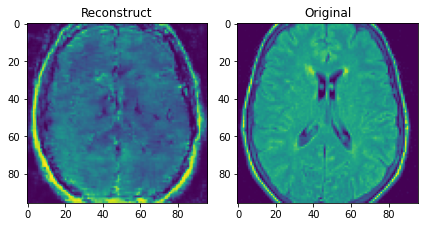

[Epoch 1920/5000] 	[D loss: 1.790] 	[G loss: 41.463]


<Figure size 432x288 with 0 Axes>

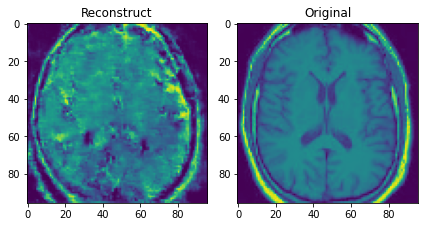

[Epoch 1940/5000] 	[D loss: 3.375] 	[G loss: 47.074]


<Figure size 432x288 with 0 Axes>

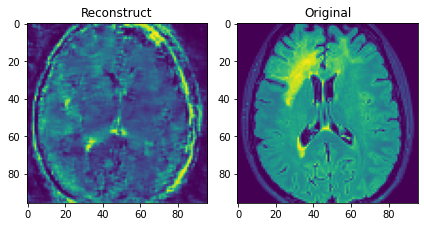

[Epoch 1960/5000] 	[D loss: 2.874] 	[G loss: 47.207]


<Figure size 432x288 with 0 Axes>

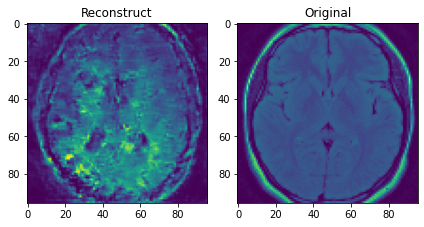

[Epoch 1980/5000] 	[D loss: 1.757] 	[G loss: 45.444]


<Figure size 432x288 with 0 Axes>

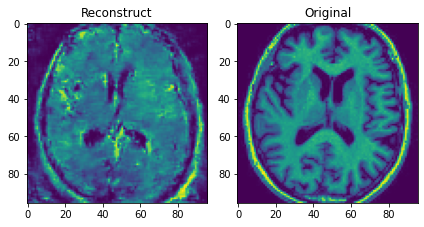

[Epoch 2000/5000] 	[D loss: 2.496] 	[G loss: 48.291]


<Figure size 432x288 with 0 Axes>

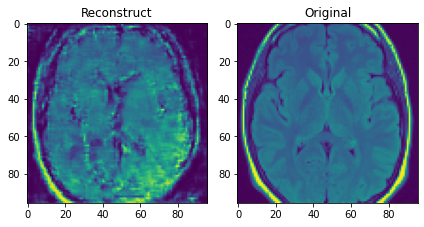

[Epoch 2020/5000] 	[D loss: 2.164] 	[G loss: 30.949]


<Figure size 432x288 with 0 Axes>

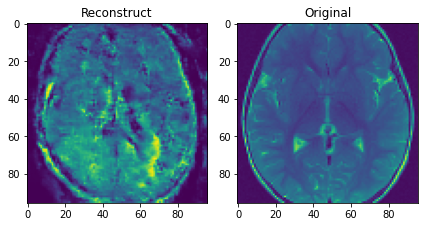

[Epoch 2040/5000] 	[D loss: 3.207] 	[G loss: 46.322]


<Figure size 432x288 with 0 Axes>

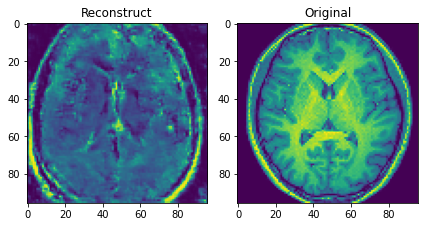

[Epoch 2060/5000] 	[D loss: 2.135] 	[G loss: 41.766]


<Figure size 432x288 with 0 Axes>

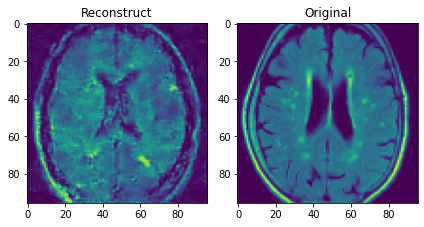

[Epoch 2080/5000] 	[D loss: 1.943] 	[G loss: 33.191]


<Figure size 432x288 with 0 Axes>

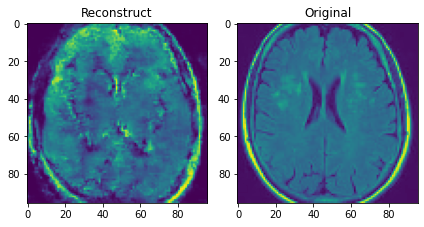

[Epoch 2100/5000] 	[D loss: 2.785] 	[G loss: 29.980]


<Figure size 432x288 with 0 Axes>

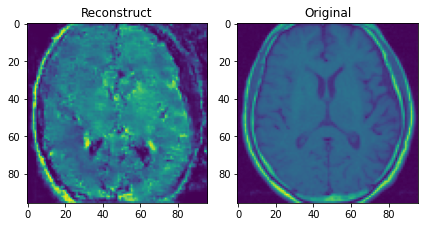

[Epoch 2120/5000] 	[D loss: 1.691] 	[G loss: 44.273]


<Figure size 432x288 with 0 Axes>

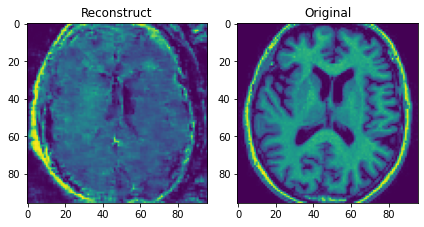

[Epoch 2140/5000] 	[D loss: 2.898] 	[G loss: 38.045]


<Figure size 432x288 with 0 Axes>

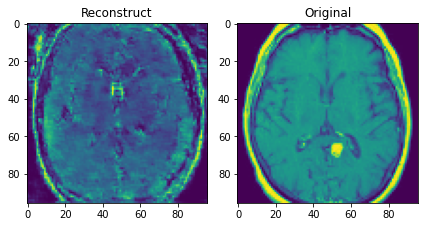

[Epoch 2160/5000] 	[D loss: 1.935] 	[G loss: 44.500]


<Figure size 432x288 with 0 Axes>

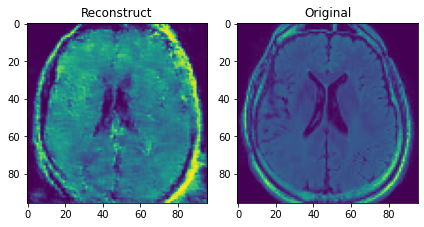

[Epoch 2180/5000] 	[D loss: 3.113] 	[G loss: 33.207]


<Figure size 432x288 with 0 Axes>

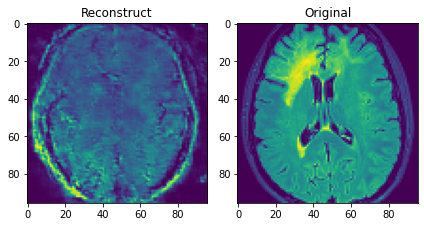

[Epoch 2200/5000] 	[D loss: 1.081] 	[G loss: 40.352]


<Figure size 432x288 with 0 Axes>

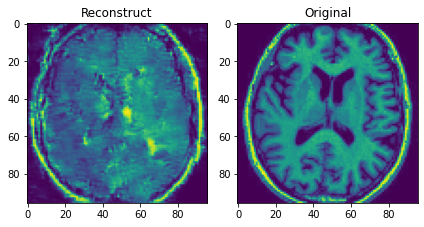

[Epoch 2220/5000] 	[D loss: 1.388] 	[G loss: 56.974]


<Figure size 432x288 with 0 Axes>

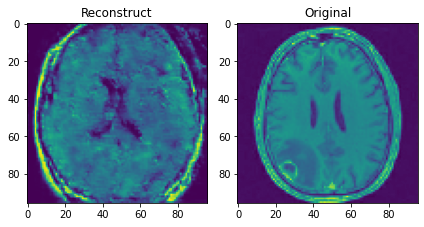

[Epoch 2240/5000] 	[D loss: 2.743] 	[G loss: 35.045]


<Figure size 432x288 with 0 Axes>

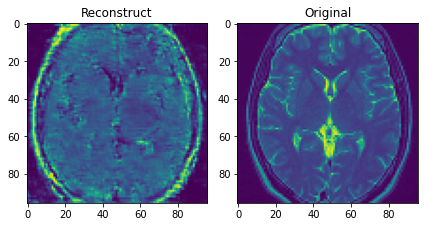

[Epoch 2260/5000] 	[D loss: 1.489] 	[G loss: 41.900]


<Figure size 432x288 with 0 Axes>

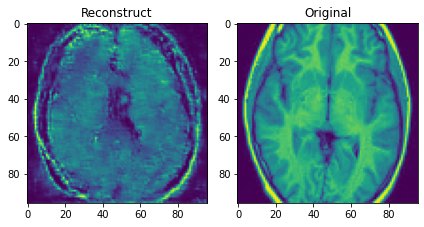

[Epoch 2280/5000] 	[D loss: 1.456] 	[G loss: 45.721]


<Figure size 432x288 with 0 Axes>

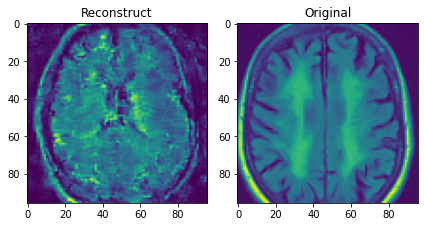

[Epoch 2300/5000] 	[D loss: 1.374] 	[G loss: 37.126]


<Figure size 432x288 with 0 Axes>

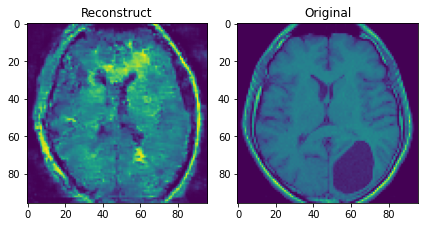

[Epoch 2320/5000] 	[D loss: 2.779] 	[G loss: 35.374]


<Figure size 432x288 with 0 Axes>

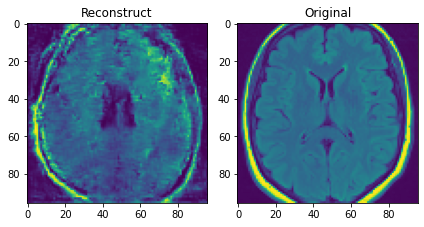

[Epoch 2340/5000] 	[D loss: 3.381] 	[G loss: 56.426]


<Figure size 432x288 with 0 Axes>

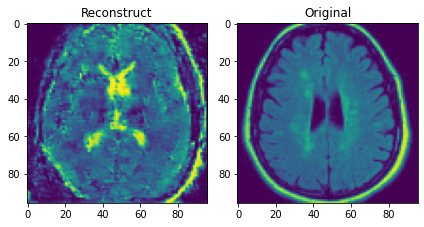

[Epoch 2360/5000] 	[D loss: 3.185] 	[G loss: 43.465]


<Figure size 432x288 with 0 Axes>

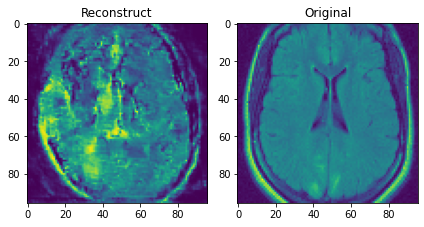

[Epoch 2380/5000] 	[D loss: 2.279] 	[G loss: 41.449]


<Figure size 432x288 with 0 Axes>

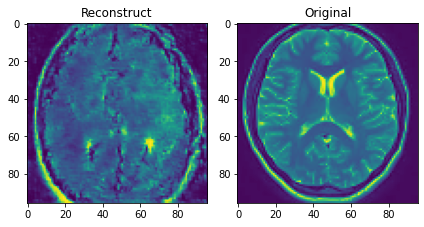

[Epoch 2400/5000] 	[D loss: 1.508] 	[G loss: 46.992]


<Figure size 432x288 with 0 Axes>

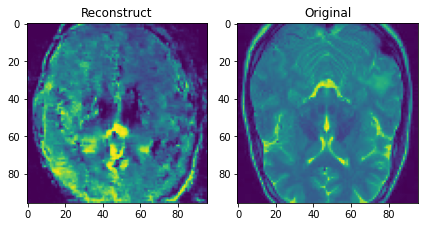

[Epoch 2420/5000] 	[D loss: 2.228] 	[G loss: 33.800]


<Figure size 432x288 with 0 Axes>

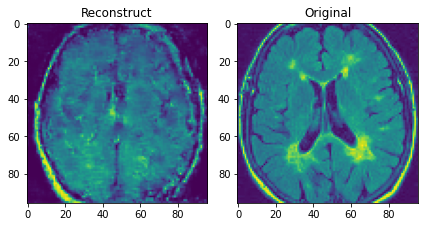

[Epoch 2440/5000] 	[D loss: 2.268] 	[G loss: 49.490]


<Figure size 432x288 with 0 Axes>

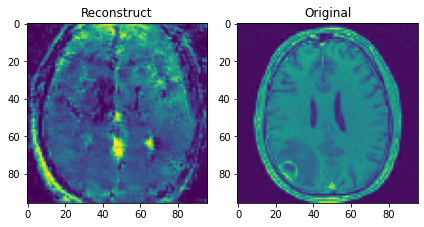

[Epoch 2460/5000] 	[D loss: 1.267] 	[G loss: 40.395]


<Figure size 432x288 with 0 Axes>

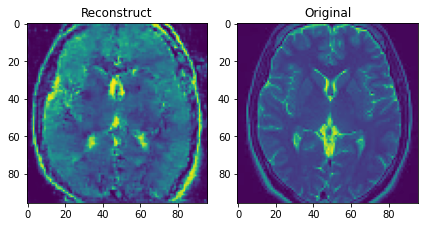

[Epoch 2480/5000] 	[D loss: 2.165] 	[G loss: 33.696]


<Figure size 432x288 with 0 Axes>

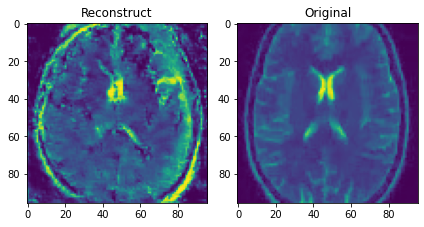

[Epoch 2500/5000] 	[D loss: 1.697] 	[G loss: 37.776]


<Figure size 432x288 with 0 Axes>

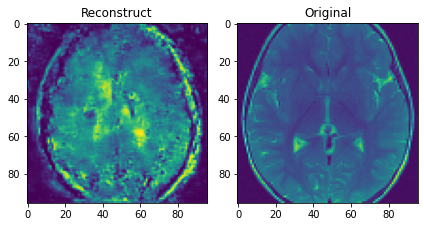

[Epoch 2520/5000] 	[D loss: 3.263] 	[G loss: 45.181]


<Figure size 432x288 with 0 Axes>

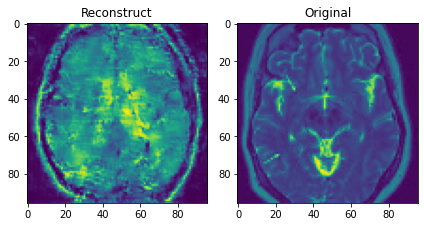

[Epoch 2540/5000] 	[D loss: 2.046] 	[G loss: 52.368]


<Figure size 432x288 with 0 Axes>

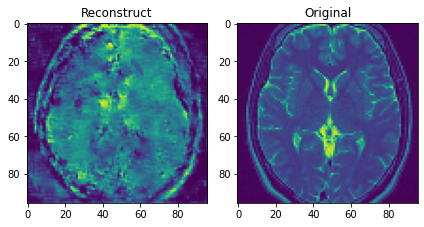

[Epoch 2560/5000] 	[D loss: 0.966] 	[G loss: 48.490]


<Figure size 432x288 with 0 Axes>

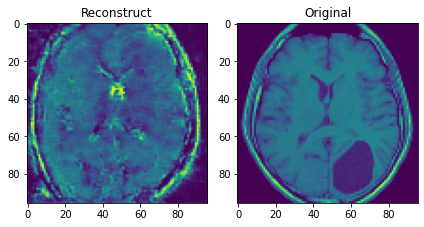

[Epoch 2580/5000] 	[D loss: 1.250] 	[G loss: 49.801]


<Figure size 432x288 with 0 Axes>

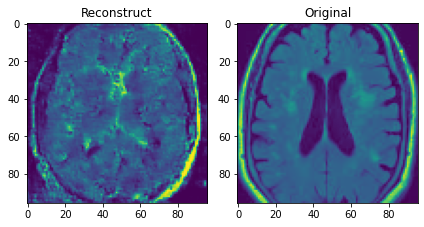

[Epoch 2600/5000] 	[D loss: 2.128] 	[G loss: 46.825]


<Figure size 432x288 with 0 Axes>

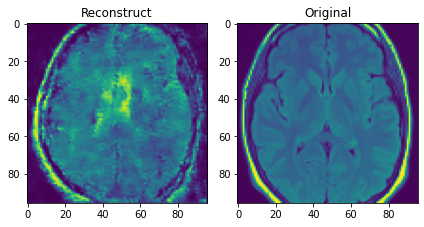

[Epoch 2620/5000] 	[D loss: 1.840] 	[G loss: 49.069]


<Figure size 432x288 with 0 Axes>

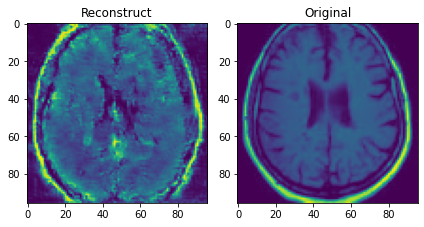

[Epoch 2640/5000] 	[D loss: 2.210] 	[G loss: 55.800]


<Figure size 432x288 with 0 Axes>

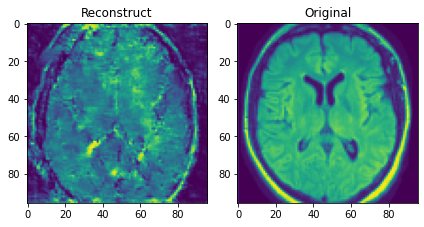

[Epoch 2660/5000] 	[D loss: 2.047] 	[G loss: 47.005]


<Figure size 432x288 with 0 Axes>

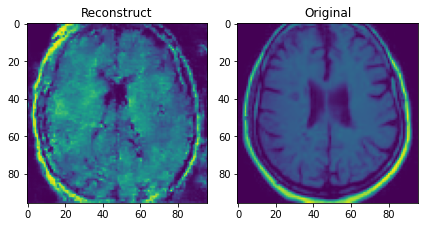

[Epoch 2680/5000] 	[D loss: 3.245] 	[G loss: 46.539]


<Figure size 432x288 with 0 Axes>

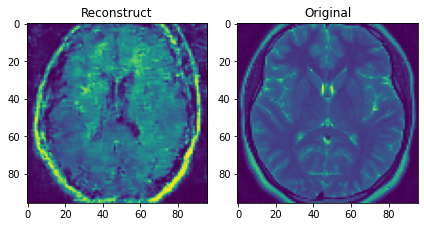

[Epoch 2700/5000] 	[D loss: 1.820] 	[G loss: 49.419]


<Figure size 432x288 with 0 Axes>

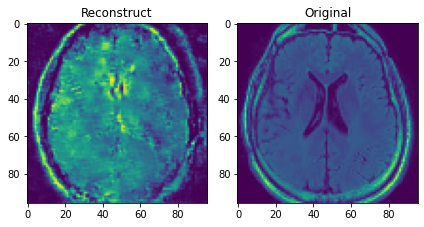

[Epoch 2720/5000] 	[D loss: 1.510] 	[G loss: 46.986]


<Figure size 432x288 with 0 Axes>

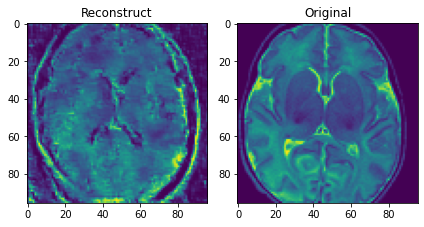

[Epoch 2740/5000] 	[D loss: 3.242] 	[G loss: 39.631]


<Figure size 432x288 with 0 Axes>

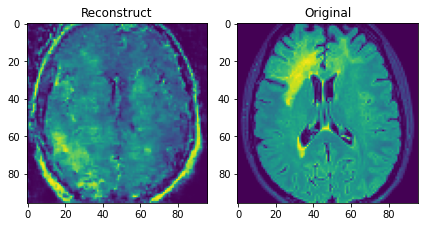

[Epoch 2760/5000] 	[D loss: 2.082] 	[G loss: 46.161]


<Figure size 432x288 with 0 Axes>

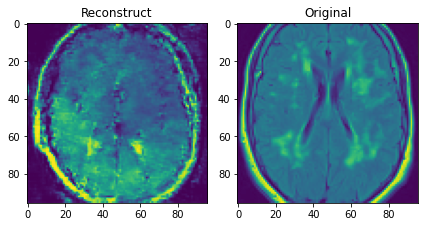

[Epoch 2780/5000] 	[D loss: 2.042] 	[G loss: 55.051]


<Figure size 432x288 with 0 Axes>

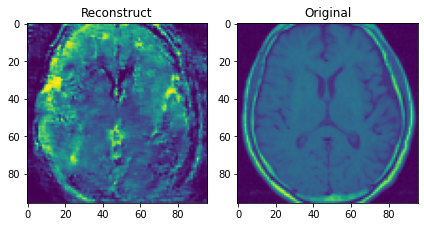

[Epoch 2800/5000] 	[D loss: 1.598] 	[G loss: 44.686]


<Figure size 432x288 with 0 Axes>

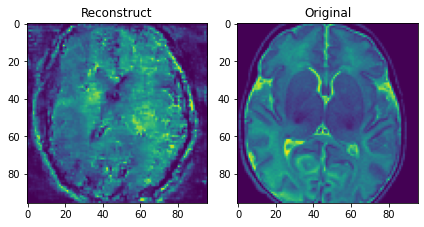

[Epoch 2820/5000] 	[D loss: 1.639] 	[G loss: 55.084]


<Figure size 432x288 with 0 Axes>

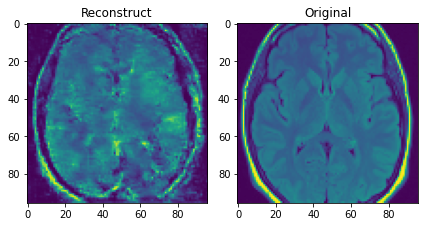

[Epoch 2840/5000] 	[D loss: 1.400] 	[G loss: 61.285]


<Figure size 432x288 with 0 Axes>

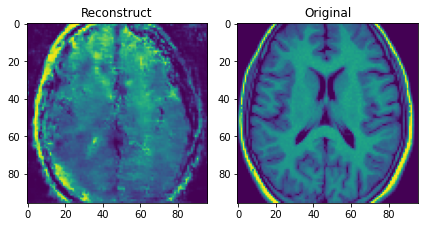

[Epoch 2860/5000] 	[D loss: 2.137] 	[G loss: 55.250]


<Figure size 432x288 with 0 Axes>

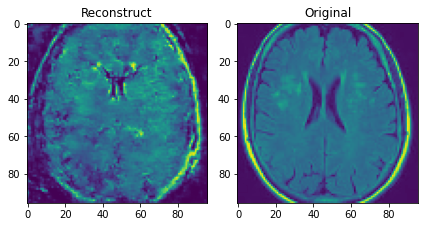

[Epoch 2880/5000] 	[D loss: 1.814] 	[G loss: 63.004]


<Figure size 432x288 with 0 Axes>

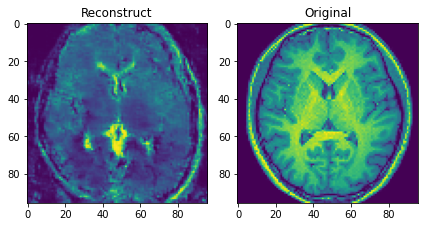

[Epoch 2900/5000] 	[D loss: 1.759] 	[G loss: 32.646]


<Figure size 432x288 with 0 Axes>

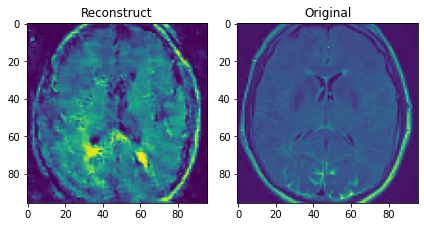

[Epoch 2920/5000] 	[D loss: 4.153] 	[G loss: 49.317]


<Figure size 432x288 with 0 Axes>

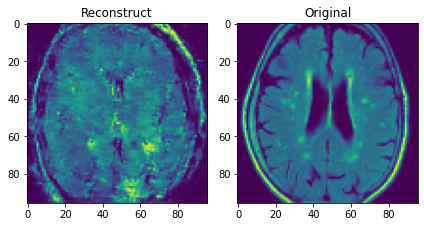

[Epoch 2940/5000] 	[D loss: 1.950] 	[G loss: 39.261]


<Figure size 432x288 with 0 Axes>

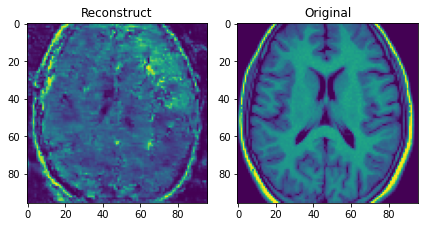

[Epoch 2960/5000] 	[D loss: 1.119] 	[G loss: 51.788]


<Figure size 432x288 with 0 Axes>

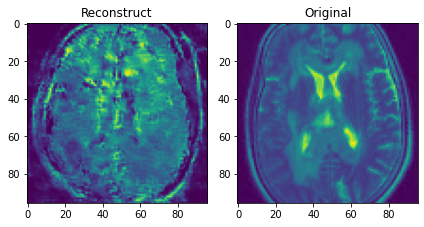

[Epoch 2980/5000] 	[D loss: 1.475] 	[G loss: 45.368]


<Figure size 432x288 with 0 Axes>

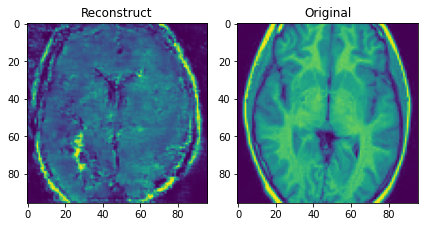

[Epoch 3000/5000] 	[D loss: 1.932] 	[G loss: 45.372]


<Figure size 432x288 with 0 Axes>

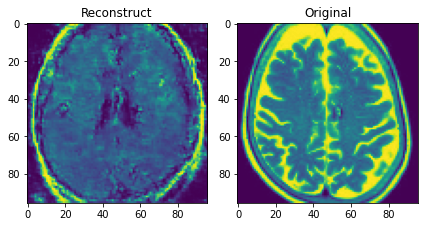

[Epoch 3020/5000] 	[D loss: 3.113] 	[G loss: 42.830]


<Figure size 432x288 with 0 Axes>

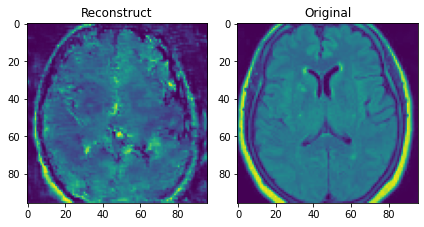

[Epoch 3040/5000] 	[D loss: 1.578] 	[G loss: 51.985]


<Figure size 432x288 with 0 Axes>

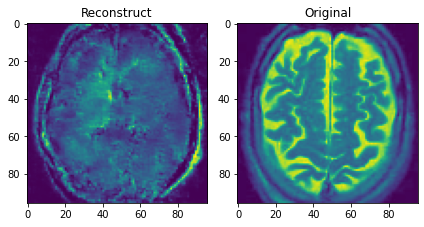

[Epoch 3060/5000] 	[D loss: 2.279] 	[G loss: 46.292]


<Figure size 432x288 with 0 Axes>

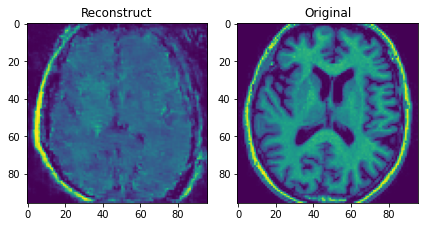

[Epoch 3080/5000] 	[D loss: 1.494] 	[G loss: 48.599]


<Figure size 432x288 with 0 Axes>

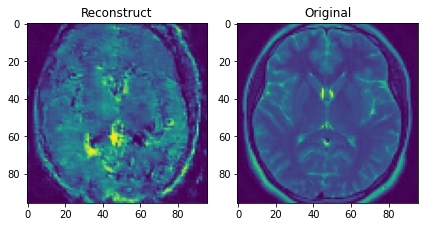

[Epoch 3100/5000] 	[D loss: 1.003] 	[G loss: 57.646]


<Figure size 432x288 with 0 Axes>

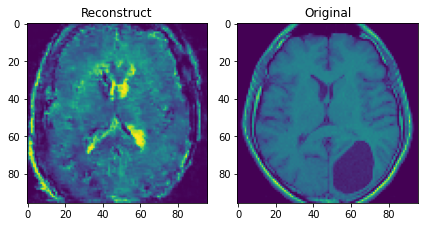

[Epoch 3120/5000] 	[D loss: 1.346] 	[G loss: 50.096]


<Figure size 432x288 with 0 Axes>

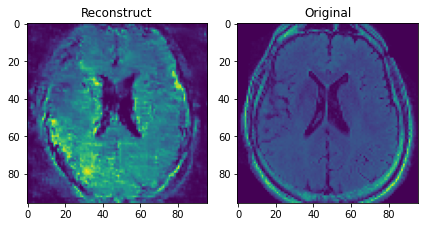

[Epoch 3140/5000] 	[D loss: 1.518] 	[G loss: 45.702]


<Figure size 432x288 with 0 Axes>

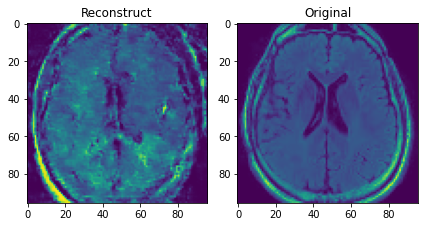

[Epoch 3160/5000] 	[D loss: 1.927] 	[G loss: 44.884]


<Figure size 432x288 with 0 Axes>

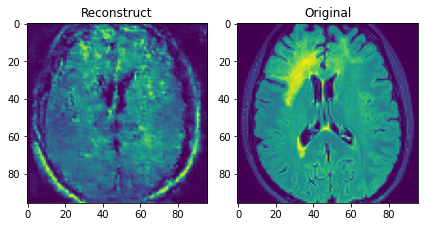

[Epoch 3180/5000] 	[D loss: 1.182] 	[G loss: 42.981]


<Figure size 432x288 with 0 Axes>

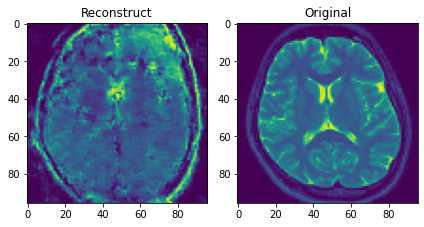

[Epoch 3200/5000] 	[D loss: 0.753] 	[G loss: 60.274]


<Figure size 432x288 with 0 Axes>

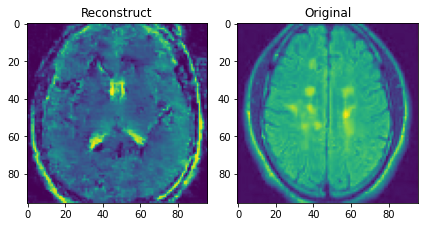

[Epoch 3220/5000] 	[D loss: 4.055] 	[G loss: 51.602]


<Figure size 432x288 with 0 Axes>

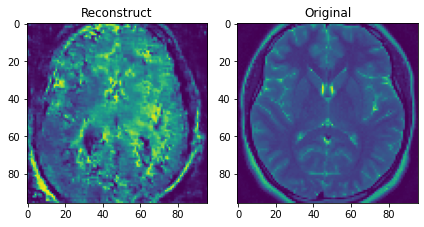

[Epoch 3240/5000] 	[D loss: 1.670] 	[G loss: 54.165]


<Figure size 432x288 with 0 Axes>

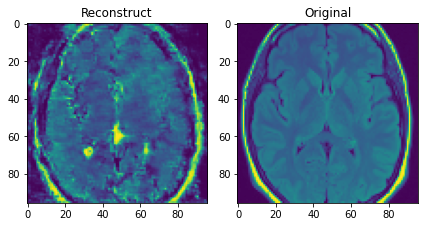

[Epoch 3260/5000] 	[D loss: 2.034] 	[G loss: 63.317]


<Figure size 432x288 with 0 Axes>

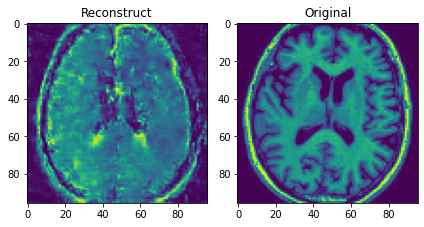

[Epoch 3280/5000] 	[D loss: 2.638] 	[G loss: 45.987]


<Figure size 432x288 with 0 Axes>

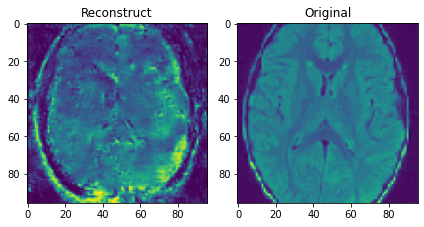

[Epoch 3300/5000] 	[D loss: 2.814] 	[G loss: 41.180]


<Figure size 432x288 with 0 Axes>

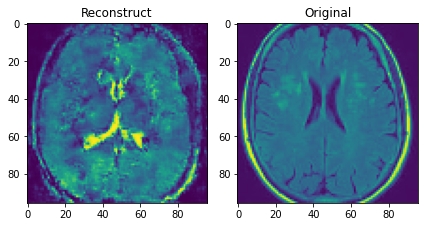

[Epoch 3320/5000] 	[D loss: 2.757] 	[G loss: 67.426]


<Figure size 432x288 with 0 Axes>

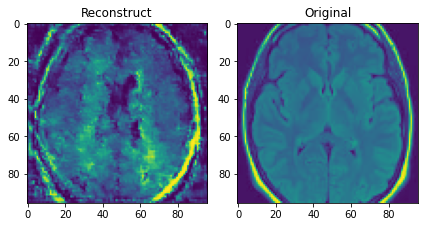

[Epoch 3340/5000] 	[D loss: 1.334] 	[G loss: 40.513]


<Figure size 432x288 with 0 Axes>

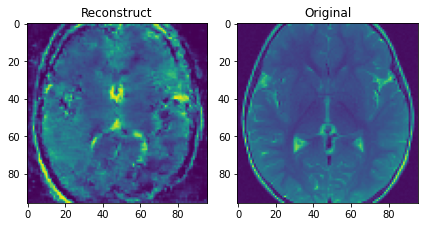

[Epoch 3360/5000] 	[D loss: 2.389] 	[G loss: 33.176]


<Figure size 432x288 with 0 Axes>

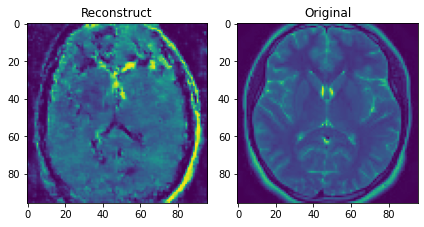

[Epoch 3380/5000] 	[D loss: 2.362] 	[G loss: 61.470]


<Figure size 432x288 with 0 Axes>

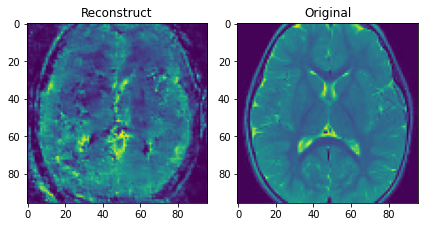

[Epoch 3400/5000] 	[D loss: 1.536] 	[G loss: 41.499]


<Figure size 432x288 with 0 Axes>

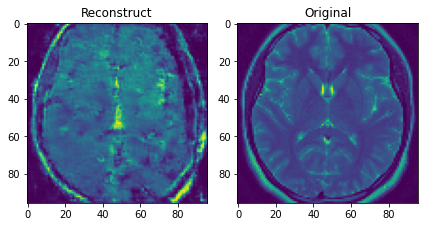

[Epoch 3420/5000] 	[D loss: 3.595] 	[G loss: 43.260]


<Figure size 432x288 with 0 Axes>

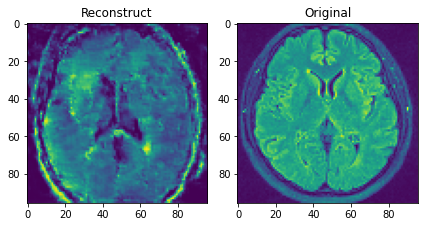

[Epoch 3440/5000] 	[D loss: 1.868] 	[G loss: 59.682]


<Figure size 432x288 with 0 Axes>

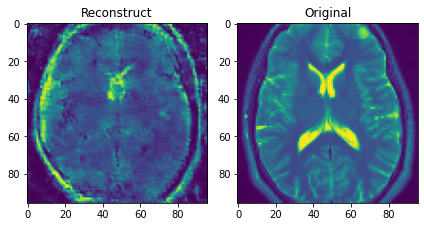

[Epoch 3460/5000] 	[D loss: 1.289] 	[G loss: 54.081]


<Figure size 432x288 with 0 Axes>

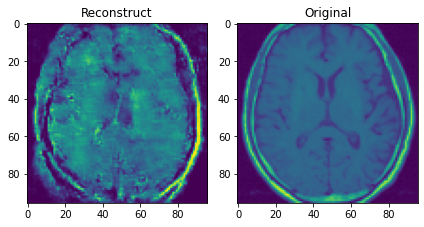

[Epoch 3480/5000] 	[D loss: 2.117] 	[G loss: 46.606]


<Figure size 432x288 with 0 Axes>

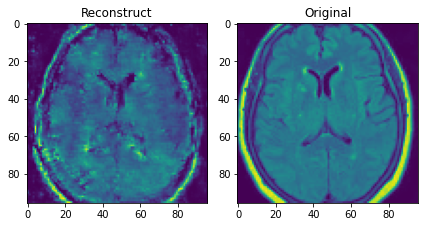

[Epoch 3500/5000] 	[D loss: 1.498] 	[G loss: 47.755]


<Figure size 432x288 with 0 Axes>

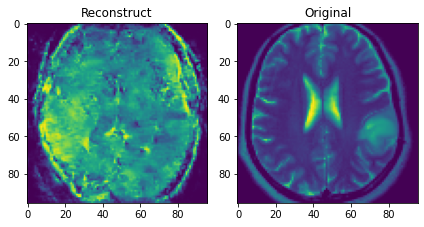

[Epoch 3520/5000] 	[D loss: 2.257] 	[G loss: 58.852]


<Figure size 432x288 with 0 Axes>

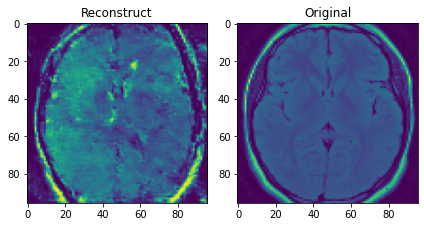

[Epoch 3540/5000] 	[D loss: 1.985] 	[G loss: 46.046]


<Figure size 432x288 with 0 Axes>

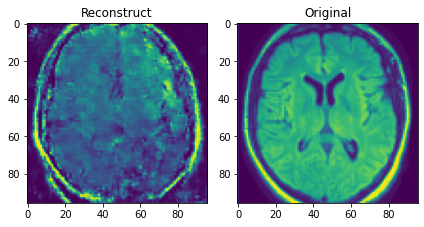

[Epoch 3560/5000] 	[D loss: 1.288] 	[G loss: 40.386]


<Figure size 432x288 with 0 Axes>

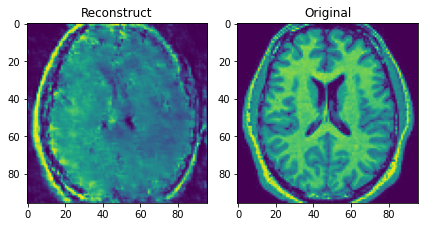

[Epoch 3580/5000] 	[D loss: 1.122] 	[G loss: 62.491]


<Figure size 432x288 with 0 Axes>

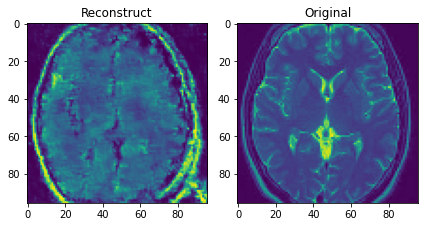

[Epoch 3600/5000] 	[D loss: 1.837] 	[G loss: 63.127]


<Figure size 432x288 with 0 Axes>

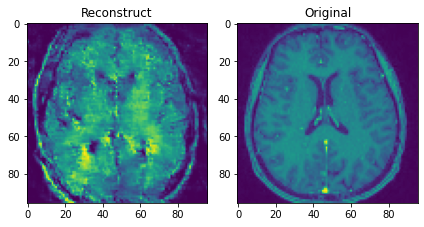

[Epoch 3620/5000] 	[D loss: 3.577] 	[G loss: 52.758]


<Figure size 432x288 with 0 Axes>

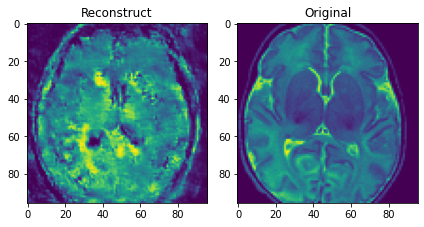

[Epoch 3640/5000] 	[D loss: 1.201] 	[G loss: 59.826]


<Figure size 432x288 with 0 Axes>

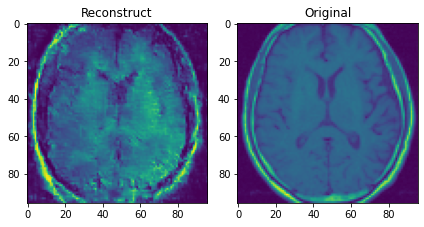

[Epoch 3660/5000] 	[D loss: 3.038] 	[G loss: 46.788]


<Figure size 432x288 with 0 Axes>

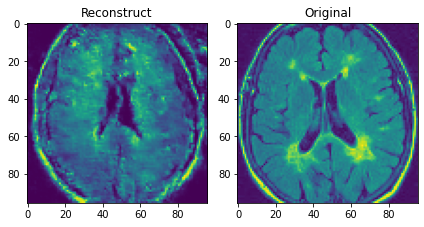

[Epoch 3680/5000] 	[D loss: 1.673] 	[G loss: 46.415]


<Figure size 432x288 with 0 Axes>

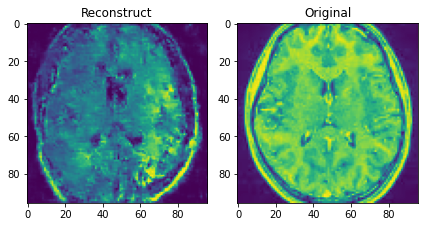

[Epoch 3700/5000] 	[D loss: 1.830] 	[G loss: 53.041]


<Figure size 432x288 with 0 Axes>

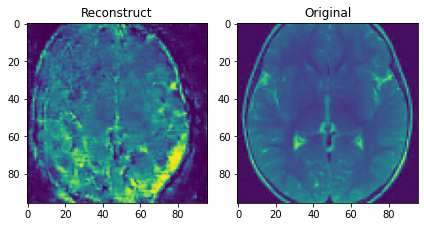

[Epoch 3720/5000] 	[D loss: 3.377] 	[G loss: 68.498]


<Figure size 432x288 with 0 Axes>

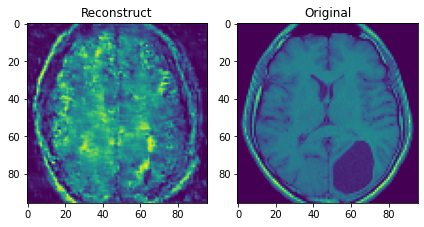

[Epoch 3740/5000] 	[D loss: 1.652] 	[G loss: 51.628]


<Figure size 432x288 with 0 Axes>

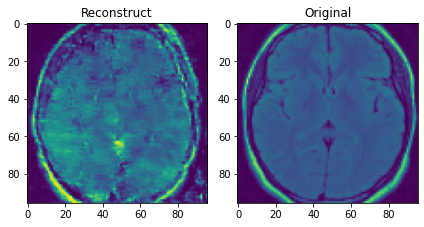

[Epoch 3760/5000] 	[D loss: 1.882] 	[G loss: 39.420]


<Figure size 432x288 with 0 Axes>

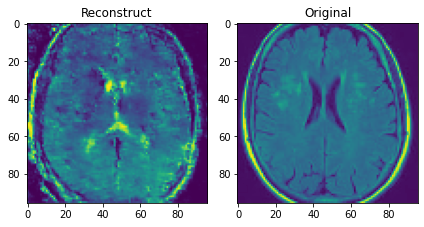

[Epoch 3780/5000] 	[D loss: 1.868] 	[G loss: 69.122]


<Figure size 432x288 with 0 Axes>

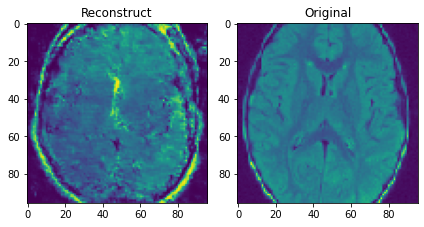

[Epoch 3800/5000] 	[D loss: 1.835] 	[G loss: 53.442]


<Figure size 432x288 with 0 Axes>

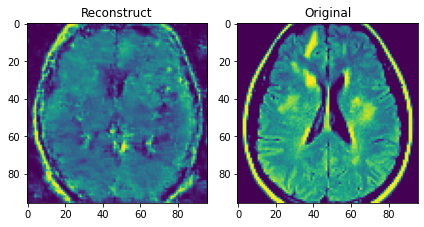

[Epoch 3820/5000] 	[D loss: 1.762] 	[G loss: 46.742]


<Figure size 432x288 with 0 Axes>

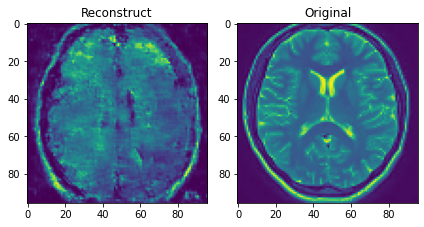

[Epoch 3840/5000] 	[D loss: 1.188] 	[G loss: 53.782]


<Figure size 432x288 with 0 Axes>

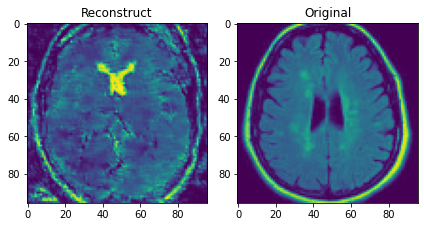

[Epoch 3860/5000] 	[D loss: 1.088] 	[G loss: 52.647]


<Figure size 432x288 with 0 Axes>

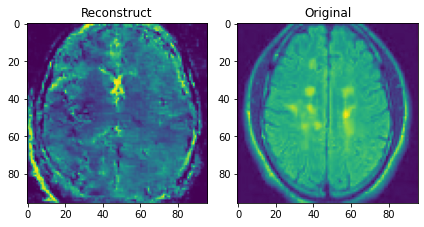

[Epoch 3880/5000] 	[D loss: 2.634] 	[G loss: 54.633]


<Figure size 432x288 with 0 Axes>

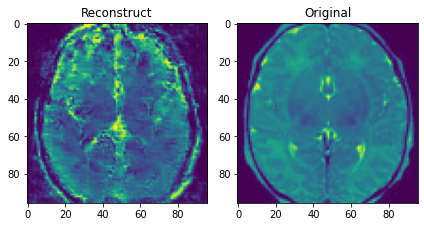

[Epoch 3900/5000] 	[D loss: 2.698] 	[G loss: 46.305]


<Figure size 432x288 with 0 Axes>

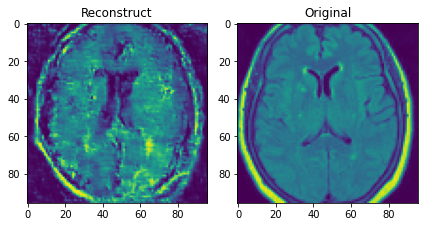

[Epoch 3920/5000] 	[D loss: 2.892] 	[G loss: 50.158]


<Figure size 432x288 with 0 Axes>

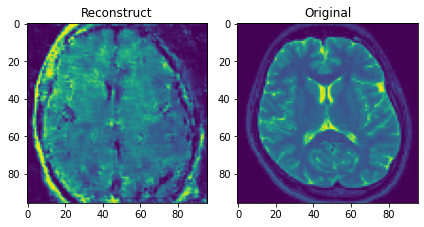

[Epoch 3940/5000] 	[D loss: 1.817] 	[G loss: 51.486]


<Figure size 432x288 with 0 Axes>

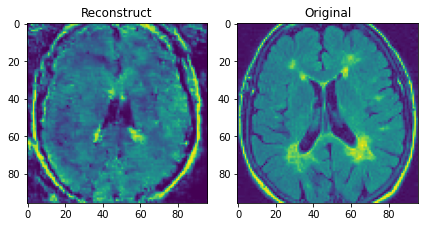

[Epoch 3960/5000] 	[D loss: 1.835] 	[G loss: 50.816]


<Figure size 432x288 with 0 Axes>

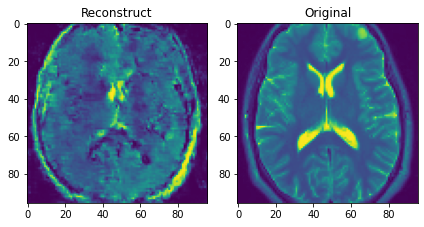

[Epoch 3980/5000] 	[D loss: 1.137] 	[G loss: 43.243]


<Figure size 432x288 with 0 Axes>

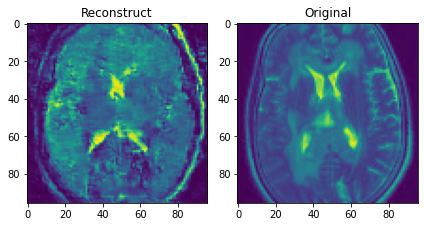

[Epoch 4000/5000] 	[D loss: 2.282] 	[G loss: 49.500]


<Figure size 432x288 with 0 Axes>

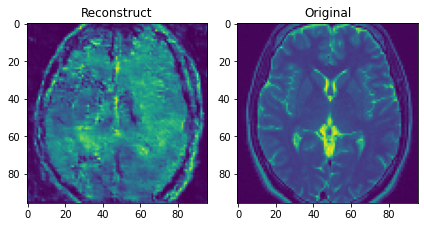

[Epoch 4020/5000] 	[D loss: 1.702] 	[G loss: 61.227]


<Figure size 432x288 with 0 Axes>

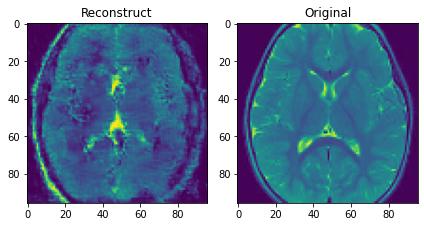

[Epoch 4040/5000] 	[D loss: 1.781] 	[G loss: 51.236]


<Figure size 432x288 with 0 Axes>

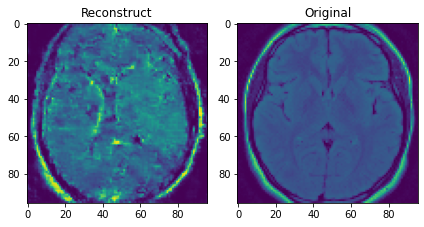

[Epoch 4060/5000] 	[D loss: 0.923] 	[G loss: 60.215]


<Figure size 432x288 with 0 Axes>

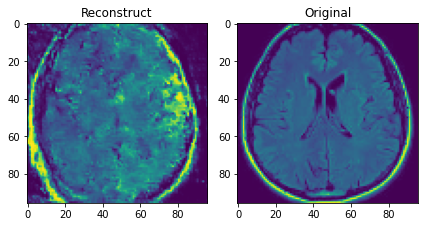

[Epoch 4080/5000] 	[D loss: 3.061] 	[G loss: 63.949]


<Figure size 432x288 with 0 Axes>

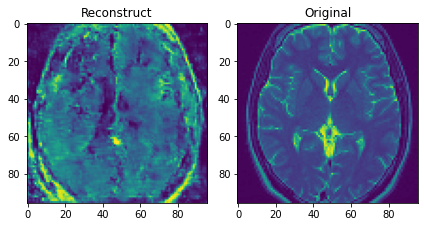

[Epoch 4100/5000] 	[D loss: 1.243] 	[G loss: 52.698]


<Figure size 432x288 with 0 Axes>

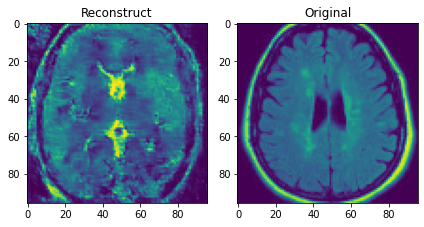

[Epoch 4120/5000] 	[D loss: 1.172] 	[G loss: 57.533]


<Figure size 432x288 with 0 Axes>

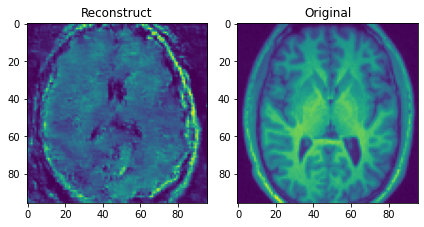

[Epoch 4140/5000] 	[D loss: 1.661] 	[G loss: 58.030]


<Figure size 432x288 with 0 Axes>

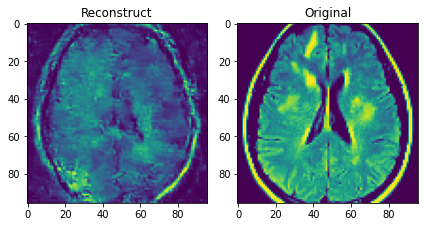

[Epoch 4160/5000] 	[D loss: 1.101] 	[G loss: 67.544]


<Figure size 432x288 with 0 Axes>

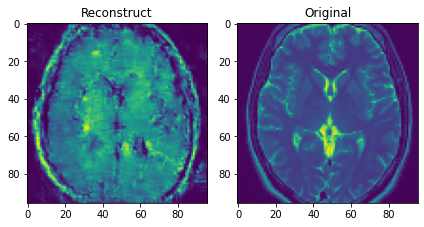

[Epoch 4180/5000] 	[D loss: 1.682] 	[G loss: 60.351]


<Figure size 432x288 with 0 Axes>

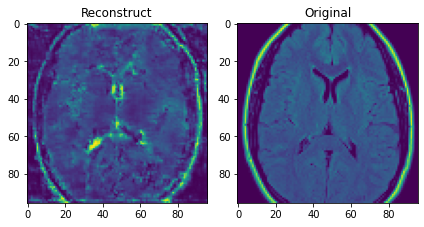

[Epoch 4200/5000] 	[D loss: 1.861] 	[G loss: 39.531]


<Figure size 432x288 with 0 Axes>

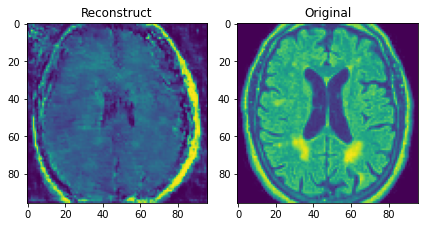

[Epoch 4220/5000] 	[D loss: 2.524] 	[G loss: 44.329]


<Figure size 432x288 with 0 Axes>

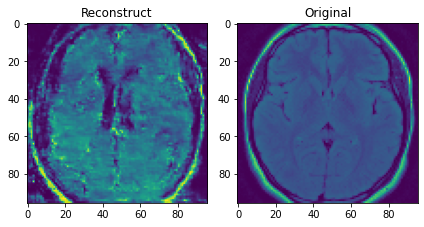

[Epoch 4240/5000] 	[D loss: 2.465] 	[G loss: 53.039]


<Figure size 432x288 with 0 Axes>

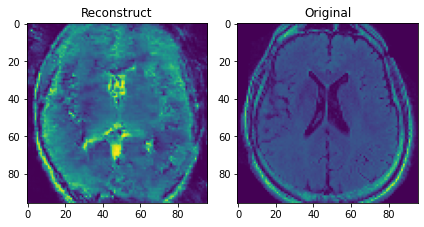

[Epoch 4260/5000] 	[D loss: 1.139] 	[G loss: 60.194]


<Figure size 432x288 with 0 Axes>

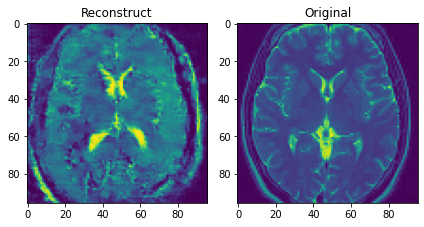

[Epoch 4280/5000] 	[D loss: 1.571] 	[G loss: 47.619]


<Figure size 432x288 with 0 Axes>

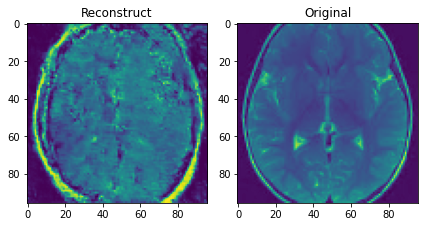

[Epoch 4300/5000] 	[D loss: 3.125] 	[G loss: 71.145]


<Figure size 432x288 with 0 Axes>

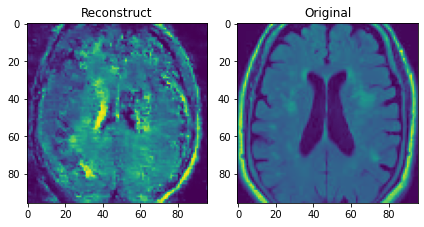

[Epoch 4320/5000] 	[D loss: 1.477] 	[G loss: 62.024]


<Figure size 432x288 with 0 Axes>

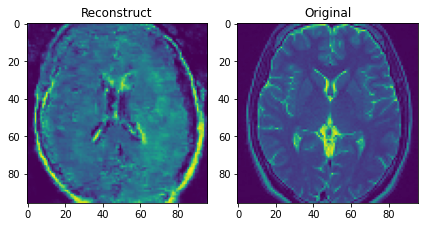

[Epoch 4340/5000] 	[D loss: 1.164] 	[G loss: 74.180]


<Figure size 432x288 with 0 Axes>

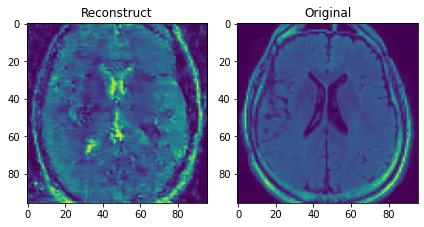

[Epoch 4360/5000] 	[D loss: 1.487] 	[G loss: 43.871]


<Figure size 432x288 with 0 Axes>

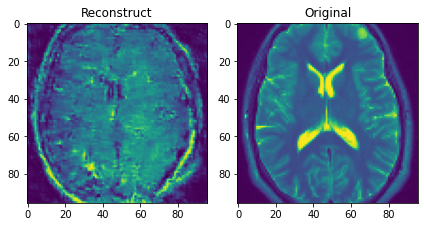

[Epoch 4380/5000] 	[D loss: 1.761] 	[G loss: 62.692]


<Figure size 432x288 with 0 Axes>

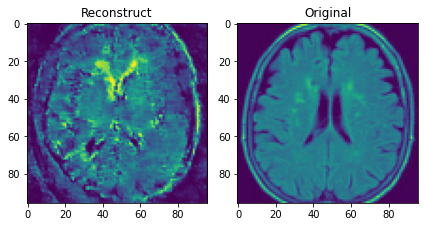

[Epoch 4400/5000] 	[D loss: 1.710] 	[G loss: 61.957]


<Figure size 432x288 with 0 Axes>

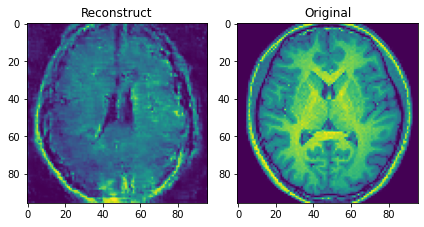

[Epoch 4420/5000] 	[D loss: 1.309] 	[G loss: 72.324]


<Figure size 432x288 with 0 Axes>

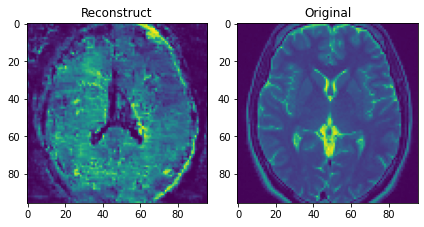

[Epoch 4440/5000] 	[D loss: 0.952] 	[G loss: 61.287]


<Figure size 432x288 with 0 Axes>

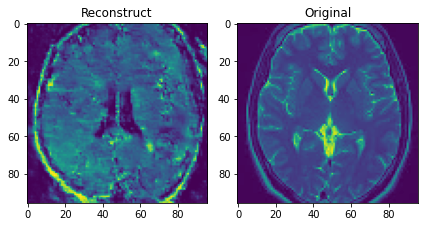

[Epoch 4460/5000] 	[D loss: 0.906] 	[G loss: 62.027]


<Figure size 432x288 with 0 Axes>

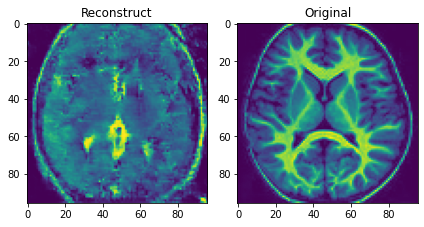

[Epoch 4480/5000] 	[D loss: 1.439] 	[G loss: 54.604]


<Figure size 432x288 with 0 Axes>

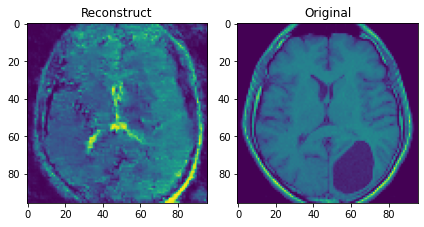

[Epoch 4500/5000] 	[D loss: 0.720] 	[G loss: 57.479]


<Figure size 432x288 with 0 Axes>

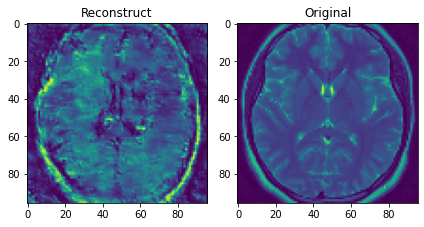

[Epoch 4520/5000] 	[D loss: 1.595] 	[G loss: 58.000]


<Figure size 432x288 with 0 Axes>

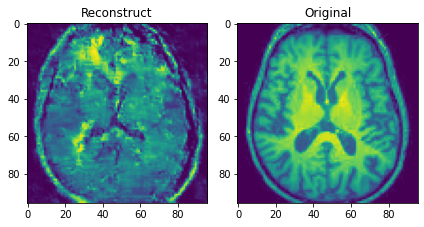

[Epoch 4540/5000] 	[D loss: 1.451] 	[G loss: 56.103]


<Figure size 432x288 with 0 Axes>

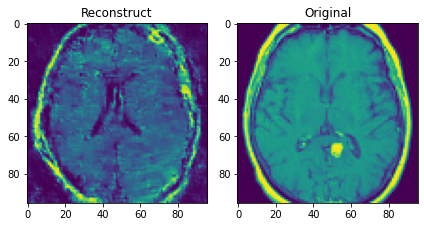

[Epoch 4560/5000] 	[D loss: 1.718] 	[G loss: 65.401]


<Figure size 432x288 with 0 Axes>

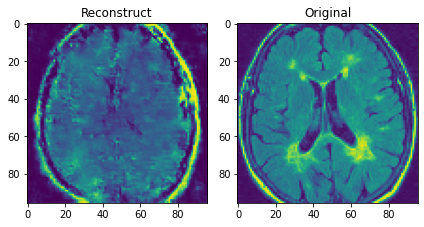

[Epoch 4580/5000] 	[D loss: 1.564] 	[G loss: 56.874]


<Figure size 432x288 with 0 Axes>

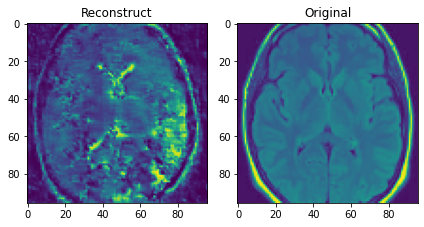

[Epoch 4600/5000] 	[D loss: 1.556] 	[G loss: 48.838]


<Figure size 432x288 with 0 Axes>

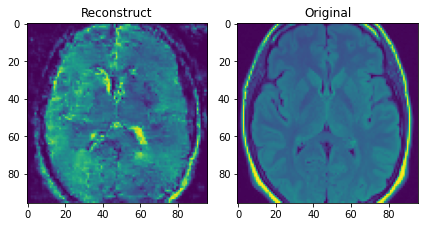

[Epoch 4620/5000] 	[D loss: 1.931] 	[G loss: 73.554]


<Figure size 432x288 with 0 Axes>

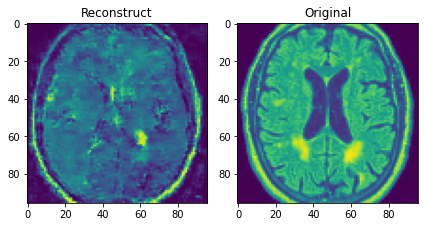

[Epoch 4640/5000] 	[D loss: 1.065] 	[G loss: 54.776]


<Figure size 432x288 with 0 Axes>

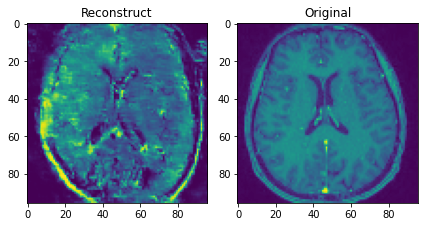

[Epoch 4660/5000] 	[D loss: 2.728] 	[G loss: 65.299]


<Figure size 432x288 with 0 Axes>

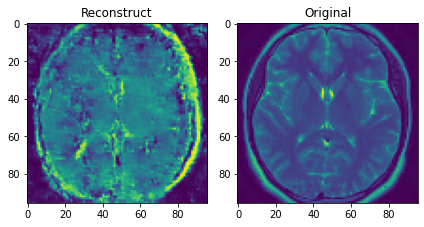

[Epoch 4680/5000] 	[D loss: 1.455] 	[G loss: 68.861]


<Figure size 432x288 with 0 Axes>

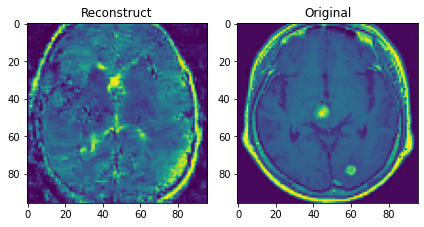

[Epoch 4700/5000] 	[D loss: 1.882] 	[G loss: 48.593]


<Figure size 432x288 with 0 Axes>

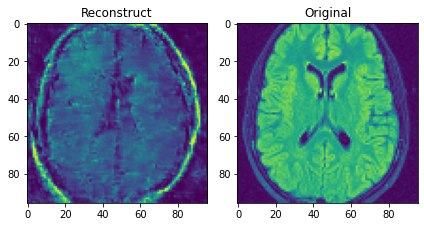

[Epoch 4720/5000] 	[D loss: 1.150] 	[G loss: 72.268]


<Figure size 432x288 with 0 Axes>

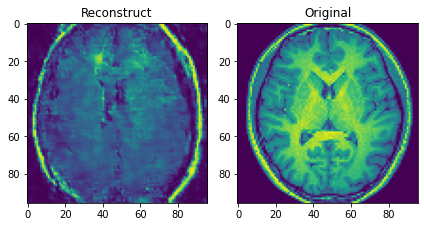

[Epoch 4740/5000] 	[D loss: 1.825] 	[G loss: 49.151]


<Figure size 432x288 with 0 Axes>

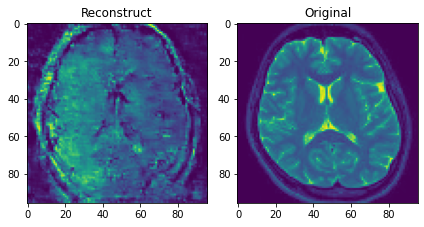

[Epoch 4760/5000] 	[D loss: 1.180] 	[G loss: 62.927]


<Figure size 432x288 with 0 Axes>

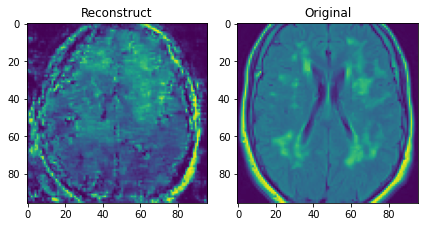

[Epoch 4780/5000] 	[D loss: 1.742] 	[G loss: 82.708]


<Figure size 432x288 with 0 Axes>

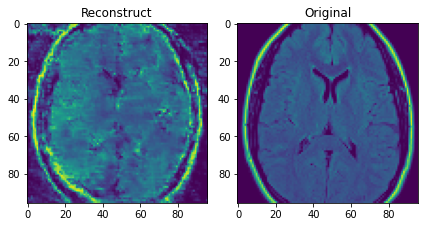

[Epoch 4800/5000] 	[D loss: 2.445] 	[G loss: 54.576]


<Figure size 432x288 with 0 Axes>

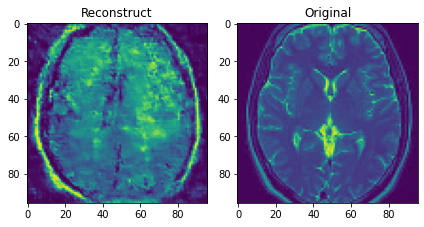

[Epoch 4820/5000] 	[D loss: 1.662] 	[G loss: 57.874]


<Figure size 432x288 with 0 Axes>

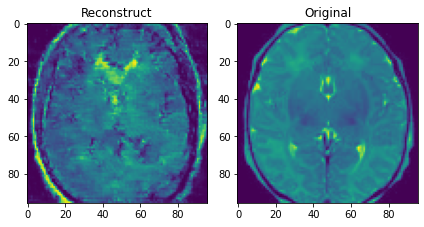

[Epoch 4840/5000] 	[D loss: 1.613] 	[G loss: 47.422]


<Figure size 432x288 with 0 Axes>

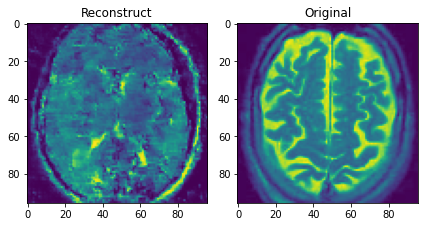

[Epoch 4860/5000] 	[D loss: 0.798] 	[G loss: 58.604]


<Figure size 432x288 with 0 Axes>

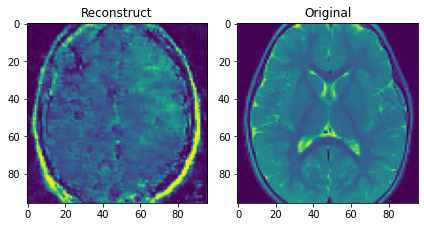

[Epoch 4880/5000] 	[D loss: 0.810] 	[G loss: 62.593]


<Figure size 432x288 with 0 Axes>

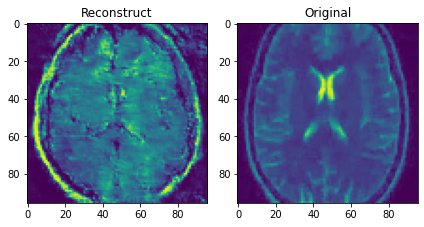

[Epoch 4900/5000] 	[D loss: 0.679] 	[G loss: 54.804]


<Figure size 432x288 with 0 Axes>

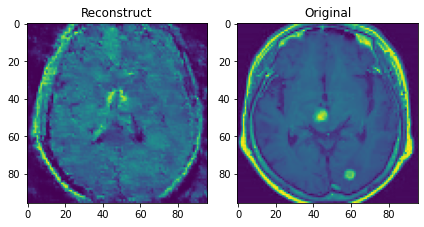

[Epoch 4920/5000] 	[D loss: 3.127] 	[G loss: 86.933]


<Figure size 432x288 with 0 Axes>

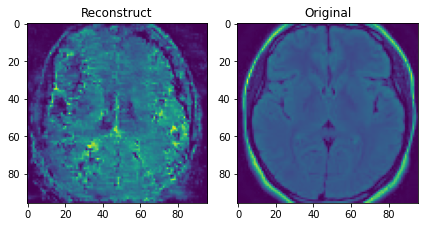

[Epoch 4940/5000] 	[D loss: 1.999] 	[G loss: 54.708]


<Figure size 432x288 with 0 Axes>

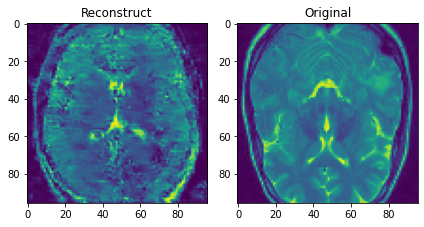

[Epoch 4960/5000] 	[D loss: 1.115] 	[G loss: 58.117]


<Figure size 432x288 with 0 Axes>

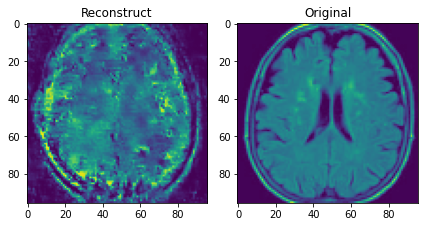

[Epoch 4980/5000] 	[D loss: 2.180] 	[G loss: 52.800]


<Figure size 432x288 with 0 Axes>

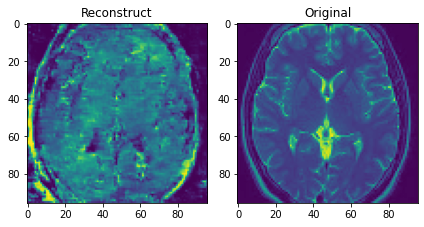

[Epoch 5000/5000] 	[D loss: 1.436] 	[G loss: 82.319]


In [31]:
for epoch in range(999, num_epochs+1):
    total_G_loss = 0.0
    total_D_loss = 0.0
    for i, (real_images, _) in enumerate(dataloader):
        valid = torch.FloatTensor(real_images.shape[0], 1).fill_(1.0).cuda()
        fake = torch.FloatTensor(real_images.shape[0], 1).fill_(0.0).cuda()
        real_images = real_images.unsqueeze(1).cuda()

        #  Train Generator
        optimizer_G.zero_grad()
        z = torch.FloatTensor(np.random.normal(0, 1, (real_images.shape[0], latent_dim))).cuda()
        gen_imgs = generator(z)
        g_loss = adversarial_loss(discriminator(gen_imgs), valid)
        g_loss.backward()
        optimizer_G.step()
        total_G_loss += g_loss.cpu().detach().numpy()

        #  Train Discriminator
        optimizer_D.zero_grad()
        discriminator_opinion_real = discriminator(real_images)
        discriminator_opinion_fake = discriminator(gen_imgs.detach())
        real_loss = adversarial_loss(discriminator_opinion_real, valid)
        fake_loss = adversarial_loss(discriminator_opinion_fake, fake)
        d_loss = (real_loss + fake_loss) / 2
        d_loss.backward()
        optimizer_D.step()
        total_D_loss += d_loss.cpu().detach().numpy()

    if epoch % sample_interval ==0:

        # show a sample from generator
        num_rnd = math.floor(np.random.uniform(0, real_images.shape[0]))
        plt.figure()
        ploter(real_images[num_rnd,0].detach().cpu(), gen_imgs[num_rnd,0].detach().cpu())
        plt.show()

        # show losses
        print(
                "[Epoch {}/{}] \t[D loss: {:.3f}] \t[G loss: {:.3f}]".format(
                    epoch, num_epochs, total_D_loss, total_G_loss)
            )

        # save all
        torch.save({"epoch": epoch,
            "state_dict_G": generator.state_dict(),
            "state_dict_D": discriminator.state_dict(),
            "optimizer_G": optimizer_G.state_dict(),
            "optimizer_D": optimizer_D.state_dict()
           }, root_save + f"/epoch_{epoch}.pt")

In [28]:
"""
if epoch % sample_interval == 0 and i % (len(dataloader)/5) == 0:
    save_image(gen_imgs.data[0,0],
               "images/{}_{}.png".format(str(epoch).zfill(len(str(num_epochs))),
                                         str(i).zfill(len(str(len(dataloader))))),
               normalize=True)
"""

'\nif epoch % sample_interval == 0 and i % (len(dataloader)/5) == 0:\n    save_image(gen_imgs.data[0,0],\n               "images/{}_{}.png".format(str(epoch).zfill(len(str(num_epochs))),\n                                         str(i).zfill(len(str(len(dataloader))))),\n               normalize=True)\n'

### End